<a href="https://colab.research.google.com/github/axios-shosan/pfe-ml-notebooks/blob/main/sentiment_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Import and download stuff


###Download

In [ ]:
!pip install nltk

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install wordcloud

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [ ]:
!pip install pyspellchecker

     |████████████████████████████████| 2.7 MB 5.6 MB/s 


###Import

In [ ]:
from google.colab import drive
import pandas as pd
import numpy as np
import nltk
from nltk import word_tokenize
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, load_model
from keras.layers import Dense, Embedding, LSTM, SpatialDropout1D, Dropout, Bidirectional
from sklearn.model_selection import train_test_split
from keras.utils.np_utils import to_categorical
import re
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.layers import GlobalMaxPool1D
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
import io 
import json

##get data from drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data1 = pd.read_csv("drive/My Drive/pfe/data_dropna_en.csv")
data2 = pd.read_csv("drive/My Drive/pfe/data_dropna_en_2.csv")
frames = [data1, data2]
df = pd.concat(frames)

In [ ]:
df

,Unnamed: 0,title,text,num_helpful_votes,date,id,ratings.service,ratings.cleanliness,ratings.overall,ratings.value,ratings.location,ratings.sleep_quality,ratings.rooms,author.username,author.num_cities,author.num_helpful_votes,author.num_reviews,author.num_type_reviews,author.id,author.location
0,0,"“Truly is ""Jewel of the Upper Wets Side""”",Stayed in a king suite for 11 nights and yes i...,0,"December 17, 2012",147643103,5.0,5.0,5.0,5.0,5.0,5.0,5.0,Papa_Panda,22.0,12.0,29.0,24.0,8C0B42FF3C0FA366A21CFD785302A032,Gold Coast
1,1,“My home away from home!”,"On every visit to NYC, the Hotel Beacon is the...",0,"December 17, 2012",147639004,5.0,5.0,5.0,5.0,5.0,5.0,5.0,Maureen V,2.0,NaN,2.0,NaN,E3C85CA9DBBBC77E0DB534ABE93E4713,"Sydney, New South Wales, Australia"
2,2,“Great Stay”,This is a great property in Midtown. We two di...,0,"December 18, 2012",147697954,4.0,5.0,4.0,4.0,5.0,4.0,4.0,vuguru,12.0,17.0,14.0,14.0,FB1032DECE1162CB3556D05F278AAFFD,Houston
3,3,“Modern Convenience”,The Andaz is a nice hotel in a central locatio...,0,"December 17, 2012",147625723,5.0,5.0,4.0,5.0,5.0,5.0,5.0,Hotel-Designer,5.0,26.0,5.0,5.0,EC3E275EE7590694889C8C7EE0D13961,"Laguna Beach, CA"
4,4,“Its the best of the Andaz Brand in the US....”,I have stayed at each of the US Andaz properti...,0,"December 17, 2012",147612823,4.0,5.0,4.0,3.0,5.0,5.0,5.0,JamesE339,34.0,65.0,104.0,49.0,BA524A238B1171206691A6CC3F28F266,"Saint Louis, Missouri"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
421386,878548,"“Perfekte Location, modernes & chices Ambiente...","Das Hotel Palomar gehoert zur Kimpton Gruppe, ...",0,"August 2, 2010",73467940,4.0,5.0,4.0,3.0,4.0,4.0,4.0,berlinrocks,3.0,NaN,3.0,3.0,D3869189DDA7EBE1067D11F92E294B1E,"Washington DC, District of Columbia"
421387,878549,“Superhotel Superlage”,Anlässlich einer Geschäftsreise waren wir das ...,0,"August 2, 2010",73351022,5.0,5.0,5.0,5.0,5.0,5.0,5.0,stellatux,3.0,NaN,3.0,NaN,3A07A1C120FBA55B39CD29140508C4F6,"Munich, Germany"
421388,878550,“das etwas andere Hotel”,"Das Hotel liegt in Arlington, eine etwas gehob...",0,"July 1, 2010",69298378,5.0,5.0,5.0,4.0,5.0,5.0,5.0,Putzi123,2.0,NaN,2.0,NaN,739C5D4C99D89623B53AAECFA0D5179D,Frankfurt
421389,878551,“RIEN DE MIEUX”,Mon mari et moi sommes restés à l'hôtel du jeu...,0,"June 29, 2010",69142709,5.0,5.0,5.0,5.0,5.0,5.0,5.0,DodieLachine,2.0,NaN,2.0,NaN,0590C30482A1E0C425B937BC43F04F9B,Lachine


In [ ]:
df_user_review = df[["ratings.overall", "text"]]

In [ ]:
df_user_review

,ratings.overall,text
0,5.0,Stayed in a king suite for 11 nights and yes i...
1,5.0,"On every visit to NYC, the Hotel Beacon is the..."
2,4.0,This is a great property in Midtown. We two di...
3,4.0,The Andaz is a nice hotel in a central locatio...
4,4.0,I have stayed at each of the US Andaz properti...
...,...,...
421386,4.0,"Das Hotel Palomar gehoert zur Kimpton Gruppe, ..."
421387,5.0,Anlässlich einer Geschäftsreise waren wir das ...
421388,5.0,"Das Hotel liegt in Arlington, eine etwas gehob..."
421389,5.0,Mon mari et moi sommes restés à l'hôtel du jeu...


In [ ]:
df_user_review['ratings.overall'].unique()

array([5., 4., 1., 3., 2.])

In [ ]:
conditions = [
    (df_user_review['ratings.overall'] <= 2.0),
    (df_user_review['ratings.overall'] == 3.0),
    (df_user_review['ratings.overall'] >= 4.0),
]

values = [-1, 0, 1]

df_user_review['sentiment'] = np.select(conditions, values)

df_user_review

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


,ratings.overall,text,sentiment
0,5.0,Stayed in a king suite for 11 nights and yes i...,1
1,5.0,"On every visit to NYC, the Hotel Beacon is the...",1
2,4.0,This is a great property in Midtown. We two di...,1
3,4.0,The Andaz is a nice hotel in a central locatio...,1
4,4.0,I have stayed at each of the US Andaz properti...,1
...,...,...,...
421386,4.0,"Das Hotel Palomar gehoert zur Kimpton Gruppe, ...",1
421387,5.0,Anlässlich einer Geschäftsreise waren wir das ...,1
421388,5.0,"Das Hotel liegt in Arlington, eine etwas gehob...",1
421389,5.0,Mon mari et moi sommes restés à l'hôtel du jeu...,1


In [ ]:
df_user_review["sentiment"].value_counts()

 1    331721
 0     61991
-1     42679
Name: sentiment, dtype: int64

#Pre-processing

###change text to lower case

In [ ]:
df_user_review['text']=df_user_review['text'].str.lower()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


###Removing Extra White spaces

In [ ]:
def remove_whitespace(text):
    return  " ".join(text.split())

df_user_review['text']=df_user_review['text'].apply(remove_whitespace)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


###tokenization

In [ ]:
df_user_review['text']=df_user_review['text'].apply(lambda X: word_tokenize(X))
df_user_review.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,ratings.overall,text,sentiment
0,5.0,"[stayed, in, a, king, suite, for, 11, nights, ...",1
1,5.0,"[on, every, visit, to, nyc, ,, the, hotel, bea...",1
2,4.0,"[this, is, a, great, property, in, midtown, .,...",1
3,4.0,"[the, andaz, is, a, nice, hotel, in, a, centra...",1
4,4.0,"[i, have, stayed, at, each, of, the, us, andaz...",1


###Spelling Correction

In [ ]:
from spellchecker import SpellChecker
def spell_check(text):
    
    result = []
    spell = SpellChecker()
    for word in text:
        correct_word = spell.correction(word)
        result.append(correct_word)
    
    return result

#Test
text = "confuson matrx".split() 
spell_check(text)

['confusion', 'matrix']

In [ ]:
df_user_review['text'] = df_user_review['text'].apply(spell_check)
df_user_review.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,author.id,ratings.overall,text,offering_id,sentiment
0,BA524A238B1171206691A6CC3F28F266,4.0,"[i, have, stayed, at, each, of, the, us, anda,...",1762573.0,1
1,2404E3630B78BB9E8D6583076FBA0742,4.0,"[we, got, a, reasonable, (, for, ny, ), rate, ...",1456560.0,1
2,212787FEB4E7A223D38277943BCA6E55,3.0,"[i, arrived, around, 8:30, pump, ,, calling, a...",93396.0,0
3,CD56112AAAD78B37A07925998DAA1A75,5.0,"[a, tonight, stay, here, for, work, was, a, gr...",239853.0,1
4,4C8EFD12CA2F03E9D85709814BB16501,5.0,"[campus, hotels, are, a, little, unpredictable...",108038.0,1


In [ ]:
df_user_review.head()

,author.id,ratings.overall,text,offering_id,sentiment
0,BA524A238B1171206691A6CC3F28F266,4.0,"[i, have, stayed, at, each, of, the, us, anda,...",1762573.0,1
1,2404E3630B78BB9E8D6583076FBA0742,4.0,"[we, got, a, reasonable, (, for, ny, ), rate, ...",1456560.0,1
2,212787FEB4E7A223D38277943BCA6E55,3.0,"[i, arrived, around, 8:30, pump, ,, calling, a...",93396.0,0
3,CD56112AAAD78B37A07925998DAA1A75,5.0,"[a, tonight, stay, here, for, work, was, a, gr...",239853.0,1
4,4C8EFD12CA2F03E9D85709814BB16501,5.0,"[campus, hotels, are, a, little, unpredictable...",108038.0,1


In [ ]:
df_user_review.to_csv('cleaned_text_data.csv')
!cp cleaned_text_data.csv "drive/My Drive/pfe/"

In [ ]:
df_user_review = pd.read_csv("drive/My Drive/pfe/cleaned_text_data.csv")

In [ ]:
df_user_review

###remove stop words and points

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
from nltk.corpus import stopwords

In [ ]:
en_stopwords = stopwords.words('english')
def remove_stopwords(text):
    result = []
    for token in text:
        if token not in en_stopwords:
            result.append(token)
            
    return result

In [ ]:
en_stopwords

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [ ]:
df_user_review['text'] = df_user_review['text'].apply(remove_stopwords)
df_user_review.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,ratings.overall,text,sentiment
0,5.0,"[stayed, king, suite, 11, nights, yes, cots, u...",1
1,5.0,"[every, visit, nyc, ,, hotel, beacon, place, l...",1
2,4.0,"[great, property, midtown, ., two, different, ...",1
3,4.0,"[andaz, nice, hotel, central, location, manhat...",1
4,4.0,"[stayed, us, andaz, properties, ,, one, best, ...",1


In [ ]:
from nltk.tokenize import RegexpTokenizer

def remove_punct(text):
    
    tokenizer = RegexpTokenizer(r"\w+")
    lst=tokenizer.tokenize(' '.join(text))
    return lst

In [ ]:
df_user_review['text'] = df_user_review['text'].apply(remove_punct)
df_user_review.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,ratings.overall,text,sentiment
0,5.0,"[stayed, king, suite, 11, nights, yes, cots, u...",1
1,5.0,"[every, visit, nyc, hotel, beacon, place, love...",1
2,4.0,"[great, property, midtown, two, different, roo...",1
3,4.0,"[andaz, nice, hotel, central, location, manhat...",1
4,4.0,"[stayed, us, andaz, properties, one, best, muc...",1


In [ ]:
df_user_review.sentiment.value_counts()

 1    331721
 0     61991
-1     42679
Name: sentiment, dtype: int64

###Stemming

In [ ]:
from nltk.stem import PorterStemmer

def stemming(text):
    porter = PorterStemmer()
    
    result=[]
    for word in text:
        result.append(porter.stem(word))
    return result


In [ ]:
df_user_review['text_without_stop_words']=df_user_review['text_without_stop_words'].apply(stemming)
df_user_review.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,author.id,ratings.overall,text,offering_id,sentiment,text_without_stop_words
0,BA524A238B1171206691A6CC3F28F266,4.0,"[stayed, us, anda, properties, one, best, much...",1762573.0,1,"[stay, us, anda, properti, one, best, much, be..."
1,2404E3630B78BB9E8D6583076FBA0742,4.0,"[got, reasonable, ny, rate, 330, free, wifi, 1...",1456560.0,1,"[got, reason, ny, rate, 330, free, wifi, 15, m..."
2,212787FEB4E7A223D38277943BCA6E55,3.0,"[arrived, around, 8, 30, pump, calling, ahead,...",93396.0,0,"[arriv, around, 8, 30, pump, call, ahead, tell..."
3,CD56112AAAD78B37A07925998DAA1A75,5.0,"[tonight, stay, work, great, experience, hotel...",239853.0,1,"[tonight, stay, work, great, experi, hotel, lo..."
4,4C8EFD12CA2F03E9D85709814BB16501,5.0,"[campus, hotels, little, unpredictable, one, s...",108038.0,1,"[campu, hotel, littl, unpredict, one, star, ro..."


### Lemmatization

In [ ]:
from nltk.stem import WordNetLemmatizer
from nltk import word_tokenize,pos_tag

def lemmatization(text):
    
    result=[]
    wordnet = WordNetLemmatizer()
    for token,tag in pos_tag(text):
        pos=tag[0].lower()
        
        if pos not in ['a', 'r', 'n', 'v']:
            pos='n'
            
        result.append(wordnet.lemmatize(token,pos))
    
    return result

#Test
text = ['running','ran','runs'] 
lemmatization(text)

['run', 'ran', 'run']

In [ ]:
df_user_review['text']=df_user_review['text'].apply(lemmatization)
df_user_review.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,ratings.overall,text,sentiment
0,5.0,"[stay, king, suite, 11, night, yes, cots, u, b...",1
1,5.0,"[every, visit, nyc, hotel, beacon, place, love...",1
2,4.0,"[great, property, midtown, two, different, roo...",1
3,4.0,"[andaz, nice, hotel, central, location, manhat...",1
4,4.0,"[stay, u, andaz, property, one, best, much, be...",1


In [ ]:
df_user_review['text'] = df_user_review['text'].map(lambda x : ' '.join(x))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df_user_review

,sentiment,text
0,1,stay u andaz property one best much better wes...
1,1,get reasonable nyc rate 330 free wi fi 15 mini...
2,0,arrive around 8 30 p m call ahead tell hotel e...
3,1,two night stay work great experience hotel s l...
4,1,campus hotel little unpredictable one star roo...
...,...,...
10353,1,loved hotel get suite king size bed spacious l...
10354,1,finally hotel act together make even business ...
10355,1,stay 3 night hotel palomar may 2010 arrive was...
10356,1,ca n t imagine could add anything already glow...


In [ ]:
df_user_review.to_csv('df_user_review_big.csv')
!cp df_user_review_big.csv "drive/My Drive/pfe/"

###wordcloud

In [ ]:
from wordcloud import WordCloud, STOPWORDS

In [ ]:
def generate_wordcloud(data, title = None):
  wordcloud = WordCloud(
      stopwords=stopwords,
      max_words=100,
      max_font_size=40, 
      scale=4).generate(str(data))
  fig = plt.figure(1, figsize=(15, 15))
  plt.axis('off')
  plt.imshow(wordcloud)
  plt.show()


In [ ]:
generate_wordcloud(df_user_review["text"])

TypeError: ignored

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
def clustering_wordcloud(df, label_column):
  """
  Fonction pour visualiser le wordcloud des différentes classes d'un dataframe
  args :
    - df : datagrame en entrée
    - label_column : le nom de la colonne contenant les labels
  """

  #Nous commençons par labeliser les labels (chaque valeur corresponds à un nombre)
  df[label_column+'_ind'] = LabelEncoder().fit_transform(df[label_column])

  #Facultatif
  #Puis nous créeons un dictionnaire pour pouvoir retrouver le nom initiale de la classe par rapport à sa valeur labelisée
  dico = {}
  preds_ind = df.sentiment_ind.unique()
  preds = df.sentiment.unique()
  for x,y in zip(df.sentiment_ind.unique(),df.sentiment.unique()):
     dico[x]=y



  #Ici nou commençons la génération des wordclouds


  k = len(preds) #Nombre de classes
  fig = plt.figure(figsize = (7 * k, 5)) 

  for pred in preds_ind:
    corpus = df[df['sentiment_ind']==pred]['text'].values #Nous récupérons les textes propre à chaque classe



    #Enfin nous générons un wordcloud pour chaque classe
    plt.subplot(1, k, pred+1)
    wordcloud = WordCloud(background_color="white", max_words=40, scale=10).generate_from_text(corpus)
    plt.imshow(wordcloud) 
    plt.axis("off")
    plt.title("Classe {}".format(dico[pred]))
  plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


TypeError: ignored

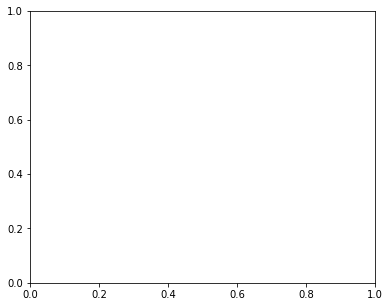

In [ ]:
clustering_wordcloud(df_user_review, 'sentiment')

In [ ]:
df_user_review.to_csv('cleaned_text_data.csv')
!cp cleaned_text_data.csv "drive/My Drive/pfe/"

In [ ]:
df_user_review = pd.read_csv("drive/My Drive/pfe/cleaned_text_data.csv")

#LSTM

###Preparing the Data

In [ ]:
df_user_review = pd.read_csv("drive/My Drive/pfe/df_user_review_big.csv")

In [ ]:
df_user_review.sentiment.value_counts()

 1    331721
 0     61991
-1     42679
Name: sentiment, dtype: int64

In [ ]:
df_user_review_positive = df_user_review.loc[df_user_review['sentiment'] == 1]

In [ ]:
df_user_review_positive = df_user_review_positive[:42679]

In [ ]:
df_user_review_negative = df_user_review.loc[df_user_review['sentiment'] == -1]

In [ ]:
df_user_review = pd.concat([df_user_review_negative, df_user_review_positive])

In [ ]:
df_user_review = df_user_review.sample(frac = 1)

In [ ]:
df_user_review = df_user_review.replace({'sentiment': {1: "positive", -1:"negative"}})

In [ ]:
df_user_review.sentiment.value_counts()

negative    42679
positive    42679
Name: sentiment, dtype: int64

##data splitting

In [ ]:
y = df_user_review.sentiment
x = df_user_review["text"][]

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(x,y, test_size = 0.2, random_state = 42, shuffle = True,)

In [ ]:
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, 
    test_size=0.25, random_state= 42) # 0.25 x 0.8 = 0.2

In [ ]:
X_train = X_train.values
Y_train = Y_train.factorize()
X_test = X_test.values
Y_test = Y_test.factorize()
X_val = X_val.values
Y_val = Y_val.factorize()

In [ ]:
Y_train[1]

Index(['negative', 'positive'], dtype='object')

##Tokenizer

In [ ]:
vocab_size = 5000
embedding_dim = 32
max_length = 200
trunc_type = 'post'
oov_tok = '<OOV>'
padding_type = 'post'

In [ ]:
tokenizer = Tokenizer(num_words=vocab_size, oov_token=oov_tok)

In [ ]:
tokenizer.fit_on_texts(df_user_review['text'].values)

In [ ]:
vocab_size = len(tokenizer.word_index) + 1

In [ ]:
X_train_token = tokenizer.texts_to_sequences(X_train)
X_train_token = pad_sequences(X_train_token, maxlen=max_length, truncating=trunc_type)

In [ ]:
X_test_token = tokenizer.texts_to_sequences(X_test)
X_test_token = pad_sequences(X_test_token, maxlen=max_length, truncating=trunc_type)

In [ ]:
X_val_token = tokenizer.texts_to_sequences(X_val)
X_val_token = pad_sequences(X_val_token, maxlen=max_length, truncating=trunc_type)

In [ ]:
def sentence_tokenize(text, maxlen=max_length, truncating=trunc_type):
  X = tokenizer.texts_to_sequences([text])
  X = pad_sequences(X, maxlen=maxlen, truncating=truncating)
  return X

In [ ]:
tokenizer_json = tokenizer.to_json()

In [ ]:
tokenizer_json

'{"class_name": "Tokenizer", "config": {"num_words": 5000, "filters": "!\\"#$%&()*+,-./:;<=>?@[\\\\]^_`{|}~\\t\\n", "lower": true, "split": " ", "char_level": false, "oov_token": "<OOV>", "document_count": 85358, "word_counts": "{\\"amount\\": 1691, \\"pay\\": 15430, \\"club\\": 3430, \\"level\\": 3312, \\"room\\": 188987, \\"extremely\\": 5976, \\"disappointed\\": 2342, \\"tiny\\": 4306, \\"bathroom\\": 23690, \\"shoddy\\": 107, \\"chip\\": 767, \\"countertop\\": 87, \\"peeling\\": 85, \\"wallpaper\\": 824, \\"tub\\": 3486, \\"spout\\": 31, \\"loose\\": 420, \\"wall\\": 9240, \\"pull\\": 2127, \\"lever\\": 47, \\"shower\\": 13882, \\"entire\\": 3092, \\"thing\\": 13654, \\"move\\": 7172, \\"felt\\": 5875, \\"like\\": 27747, \\"go\\": 42896, \\"rip\\": 889, \\"continental\\": 1874, \\"breakfast\\": 23087, \\"lounge\\": 3427, \\"consist\\": 496, \\"hard\\": 4013, \\"bagel\\": 1227, \\"cold\\": 3938, \\"cereal\\": 1047, \\"boil\\": 252, \\"egg\\": 1541, \\"cost\\": 4213, \\"15\\": 4706, 

In [ ]:
with io.open('tokenizer.json', 'w', encoding='utf-8') as f:
    f.write(json.dumps(tokenizer_json, ensure_ascii=False))

##Normal Model

In [ ]:
embedding_vector_length = 32
model = Sequential()
model.add(Embedding(vocab_size, embedding_vector_length,     
                                     input_length=200) )
model.add(SpatialDropout1D(0.25))
model.add(LSTM(50, dropout=0.5, recurrent_dropout=0.5))
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy',optimizer='adam', 
                           metrics=['accuracy'])
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 200, 32)           4304640   
                                                                 
 spatial_dropout1d_1 (Spatia  (None, 200, 32)          0         
 lDropout1D)                                                     
                                                                 
 lstm_1 (LSTM)               (None, 50)                16600     
                                                                 
 dropout_1 (Dropout)         (None, 50)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 4,321,291
Trainable params: 4,321,291
Non-trainable params: 0
____________________________________________

In [ ]:
es = EarlyStopping(monitor = 'val_loss', mode = 'min', verbose = 1, patience = 5)
mc = ModelCheckpoint('./best.h5', monitor = 'val_accuracy', mode = 'max', verbose = 1, save_best_only = True)

In [ ]:
batch_size = 32
model.fit(
          X_train_token,
          Y_train[0],
          validation_data=(X_test_token, Y_test[0]),
          epochs = 20,
          batch_size=batch_size, 
          verbose = 2,
          callbacks=[es, mc]
          )

Epoch 1/20

Epoch 1: val_accuracy improved from -inf to 0.94277, saving model to ./best.h5
1601/1601 - 443s - loss: 0.2434 - accuracy: 0.9024 - val_loss: 0.1527 - val_accuracy: 0.9428 - 443s/epoch - 277ms/step
Epoch 2/20

Epoch 2: val_accuracy improved from 0.94277 to 0.94506, saving model to ./best.h5
1601/1601 - 437s - loss: 0.1455 - accuracy: 0.9480 - val_loss: 0.1623 - val_accuracy: 0.9451 - 437s/epoch - 273ms/step
Epoch 3/20

Epoch 3: val_accuracy improved from 0.94506 to 0.94716, saving model to ./best.h5
1601/1601 - 436s - loss: 0.1261 - accuracy: 0.9539 - val_loss: 0.1473 - val_accuracy: 0.9472 - 436s/epoch - 272ms/step
Epoch 4/20

Epoch 4: val_accuracy improved from 0.94716 to 0.94763, saving model to ./best.h5
1601/1601 - 437s - loss: 0.1063 - accuracy: 0.9621 - val_loss: 0.1585 - val_accuracy: 0.9476 - 437s/epoch - 273ms/step
Epoch 5/20

Epoch 5: val_accuracy did not improve from 0.94763
1601/1601 - 440s - loss: 0.0994 - accuracy: 0.9640 - val_loss: 0.1668 - val_accuracy: 0.

In [ ]:
!cp best.h5 "drive/My Drive/pfe/"

In [ ]:
test_word ="that is bad"
tw = tokenizer.texts_to_sequences([test_word])
tw = pad_sequences(tw,maxlen=200)
prediction = int(model.predict(tw).round().item())
Y_test[1][prediction]

'positive'

##LSTM with Word2vec

In [ ]:
!pip install gensim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import gensim.downloader as api
glove_gensim  = api.load('glove-wiki-gigaword-300') #300 dimension

[==================================================] 100.0% 376.1/376.1MB downloaded


In [ ]:
vector_size = 300
gensim_weight_matrix = np.zeros((vocab_size ,vector_size))
gensim_weight_matrix.shape

(134520, 300)

In [ ]:
for word, index in tokenizer.word_index.items():
    if index < vocab_size: # since index starts with zero 
        if word in glove_gensim.wv.vocab:
            gensim_weight_matrix[index] = glove_gensim[word]
        else:
            gensim_weight_matrix[index] = np.zeros(300)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
EMBEDDING_DIM = 300
class_num = 1
model = Sequential()
model.add(Embedding(input_dim = vocab_size,
 output_dim = EMBEDDING_DIM,
 input_length= X_train_token.shape[1],
 weights = [gensim_weight_matrix],trainable = False))

model.add(SpatialDropout1D(0.25))
model.add(LSTM(50, dropout=0.5, recurrent_dropout=0.5))
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy',optimizer='adam', 
                           metrics=['accuracy'])
print(model.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_4 (Embedding)     (None, 200, 300)          40356000  
                                                                 
 spatial_dropout1d_4 (Spatia  (None, 200, 300)         0         
 lDropout1D)                                                     
                                                                 
 lstm_4 (LSTM)               (None, 50)                70200     
                                                                 
 dropout_4 (Dropout)         (None, 50)                0         
                                                                 
 dense_4 (Dense)             (None, 1)                 51        
                                                                 
Total params: 40,426,251
Trainable params: 70,251
Non-trainable params: 40,356,000
_____________________________________

In [ ]:
es = EarlyStopping(monitor = 'val_loss', mode = 'min', verbose = 1, patience = 5)
mc = ModelCheckpoint('./model_word2vec3.h5', monitor = 'val_accuracy', mode = 'max', verbose = 1, save_best_only = True)

In [ ]:
history_embedding = model.fit(X_train_token, Y_train[0], 
                                epochs = 25, batch_size = 120, 
                                validation_data=(X_test_token, Y_test[0]),
                                verbose = 2, callbacks= [es, mc]  )

Epoch 1/25

Epoch 1: val_accuracy improved from -inf to 0.88677, saving model to ./model_word2vec3.h5
427/427 - 433s - loss: 0.3909 - accuracy: 0.8175 - val_loss: 0.2740 - val_accuracy: 0.8868 - 433s/epoch - 1s/step
Epoch 2/25

Epoch 2: val_accuracy improved from 0.88677 to 0.89749, saving model to ./model_word2vec3.h5
427/427 - 399s - loss: 0.2751 - accuracy: 0.8806 - val_loss: 0.2491 - val_accuracy: 0.8975 - 399s/epoch - 935ms/step
Epoch 3/25

Epoch 3: val_accuracy improved from 0.89749 to 0.91553, saving model to ./model_word2vec3.h5
427/427 - 399s - loss: 0.2454 - accuracy: 0.8925 - val_loss: 0.2013 - val_accuracy: 0.9155 - 399s/epoch - 935ms/step
Epoch 4/25

Epoch 4: val_accuracy improved from 0.91553 to 0.92502, saving model to ./model_word2vec3.h5
427/427 - 398s - loss: 0.2259 - accuracy: 0.9029 - val_loss: 0.1977 - val_accuracy: 0.9250 - 398s/epoch - 933ms/step
Epoch 5/25

Epoch 5: val_accuracy did not improve from 0.92502
427/427 - 397s - loss: 0.2096 - accuracy: 0.9131 - val_

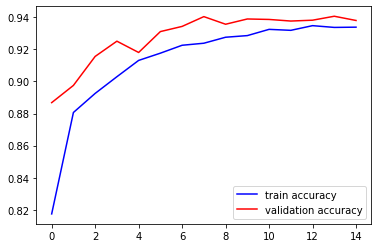

In [ ]:
plt.plot(history_embedding.history['accuracy'],c='b',label='train accuracy')
plt.plot(history_embedding.history['val_accuracy'],c='r',label='validation accuracy')
plt.legend(loc='lower right')
plt.show()

In [ ]:
word2vec_model = load_model("drive/My Drive/pfe/model_word2vec3.h5")

In [ ]:
test_word ="GREAT LOVE AMAZING"
tw = tokenizer.texts_to_sequences([test_word])
tw = pad_sequences(tw,maxlen=200)
prediction = int((word2vec_model.predict(tw)*5).round().item())
prediction

0

In [ ]:
test_word ="that is bad"
tw = tokenizer.texts_to_sequences([test_word])
tw = pad_sequences(tw,maxlen=200)
prediction = int(word2vec_model.predict(tw).round().item())
Y_test[1][prediction]

'negative'

##Another DataBase

###Prepare Data

In [ ]:
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
! kaggle datasets download crowdflower/twitter-airline-sentiment


  0% 0.00/2.55M [00:00<?, ?B/s]
100% 2.55M/2.55M [00:00<00:00, 111MB/s]


In [ ]:
! unzip twitter-airline-sentiment.zip

Archive:  twitter-airline-sentiment.zip
  inflating: Tweets.csv              
  inflating: database.sqlite         


In [ ]:
df_twitter = pd.read_csv("Tweets.csv")

In [ ]:
df_twitter

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,570306133677760513,neutral,1.0000,NaN,NaN,Virgin America,NaN,cairdin,NaN,0,@VirginAmerica What @dhepburn said.,NaN,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada)
1,570301130888122368,positive,0.3486,NaN,0.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica plus you've added commercials t...,NaN,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada)
2,570301083672813571,neutral,0.6837,NaN,NaN,Virgin America,NaN,yvonnalynn,NaN,0,@VirginAmerica I didn't today... Must mean I n...,NaN,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,570301031407624196,negative,1.0000,Bad Flight,0.7033,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica it's really aggressive to blast...,NaN,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada)
4,570300817074462722,negative,1.0000,Can't Tell,1.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica and it's a really big bad thing...,NaN,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14635,569587686496825344,positive,0.3487,NaN,0.0000,American,NaN,KristenReenders,NaN,0,@AmericanAir thank you we got on a different f...,NaN,2015-02-22 12:01:01 -0800,NaN,NaN
14636,569587371693355008,negative,1.0000,Customer Service Issue,1.0000,American,NaN,itsropes,NaN,0,@AmericanAir leaving over 20 minutes Late Flig...,NaN,2015-02-22 11:59:46 -0800,Texas,NaN
14637,569587242672398336,neutral,1.0000,NaN,NaN,American,NaN,sanyabun,NaN,0,@AmericanAir Please bring American Airlines to...,NaN,2015-02-22 11:59:15 -0800,"Nigeria,lagos",NaN
14638,569587188687634433,negative,1.0000,Customer Service Issue,0.6659,American,NaN,SraJackson,NaN,0,"@AmericanAir you have my money, you change my ...",NaN,2015-02-22 11:59:02 -0800,New Jersey,Eastern Time (US & Canada)


In [ ]:
tweet_df = df_twitter[['text','airline_sentiment']]

In [ ]:
tweet_df = tweet_df[tweet_df['airline_sentiment'] != 'neutral']

In [ ]:
y = tweet_df.airline_sentiment
x = tweet_df["text"]

In [ ]:
y

1        positive
3        negative
4        negative
5        negative
6        positive
           ...   
14633    negative
14634    negative
14635    positive
14636    negative
14638    negative
Name: airline_sentiment, Length: 11541, dtype: object

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(x,y, test_size = 0.2, random_state = 42, shuffle = True,)

In [ ]:
X_train = X_train.values
Y_train = Y_train.factorize()
X_test = X_test.values
Y_test = Y_test.factorize()

In [ ]:
vocab_size = 5000
embedding_dim = 32
max_length = 200
trunc_type = 'post'
oov_tok = '<OOV>'
padding_type = 'post'

In [ ]:
tokenizer = Tokenizer(num_words=vocab_size, oov_token=oov_tok)

In [ ]:
tokenizer.fit_on_texts(tweet_df['text'].values)

In [ ]:
vocab_size = len(tokenizer.word_index) + 1

In [ ]:
X_train_token = tokenizer.texts_to_sequences(X_train)
X_train_token = pad_sequences(X_train_token, maxlen=max_length, truncating=trunc_type)

In [ ]:
X_test_token = tokenizer.texts_to_sequences(X_test)
X_test_token = pad_sequences(X_test_token, maxlen=max_length, truncating=trunc_type)

###Normal Model

In [ ]:
tweet = tweet_df.text.values
tokenizer = Tokenizer(num_words=5000)
tokenizer.fit_on_texts(tweet)
vocab_size = len(tokenizer.word_index) + 1
encoded_docs = tokenizer.texts_to_sequences(tweet)
padded_sequence = pad_sequences(encoded_docs, maxlen=200)

In [ ]:
embedding_vector_length = 32
model = Sequential()
model.add(Embedding(vocab_size, embedding_vector_length,     
                                     input_length=200) )
model.add(SpatialDropout1D(0.25))
model.add(LSTM(50, dropout=0.5, recurrent_dropout=0.5))
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy',optimizer='adam', 
                           metrics=['accuracy'])
print(model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 200, 32)           423488    
                                                                 
 spatial_dropout1d (SpatialD  (None, 200, 32)          0         
 ropout1D)                                                       
                                                                 
 lstm (LSTM)                 (None, 50)                16600     
                                                                 
 dropout (Dropout)           (None, 50)                0         
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 440,139
Trainable params: 440,139
Non-trainable params: 0
__________________________________________________

In [ ]:
es = EarlyStopping(monitor = 'val_loss', mode = 'min', verbose = 1, patience = 5)
mc = ModelCheckpoint('./twitter.h5', monitor = 'val_accuracy', mode = 'max', verbose = 1, save_best_only = True)

In [ ]:
batch_size = 32
model.fit(
          X_train_token,
          Y_train[0],
          validation_data=(X_test_token, Y_test[0]),
          epochs = 20,
          batch_size=batch_size, 
          verbose = 2,
          callbacks=[es, mc]
          )

Epoch 1/20

Epoch 1: val_accuracy improved from -inf to 0.92074, saving model to ./twitter.h5
289/289 - 99s - loss: 0.3944 - accuracy: 0.8373 - val_loss: 0.2077 - val_accuracy: 0.9207 - 99s/epoch - 343ms/step
Epoch 2/20

Epoch 2: val_accuracy improved from 0.92074 to 0.93677, saving model to ./twitter.h5
289/289 - 74s - loss: 0.2271 - accuracy: 0.9132 - val_loss: 0.1647 - val_accuracy: 0.9368 - 74s/epoch - 255ms/step
Epoch 3/20

Epoch 3: val_accuracy improved from 0.93677 to 0.94370, saving model to ./twitter.h5
289/289 - 70s - loss: 0.1642 - accuracy: 0.9401 - val_loss: 0.1650 - val_accuracy: 0.9437 - 70s/epoch - 244ms/step
Epoch 4/20

Epoch 4: val_accuracy did not improve from 0.94370
289/289 - 70s - loss: 0.1459 - accuracy: 0.9462 - val_loss: 0.1736 - val_accuracy: 0.9389 - 70s/epoch - 242ms/step
Epoch 5/20

Epoch 5: val_accuracy improved from 0.94370 to 0.94716, saving model to ./twitter.h5
289/289 - 70s - loss: 0.1113 - accuracy: 0.9582 - val_loss: 0.1814 - val_accuracy: 0.9472 - 

In [ ]:
!cp twitter.h5 "drive/My Drive/pfe/"

In [ ]:
test_word ="This is soo pretty good"
tw = tokenizer.texts_to_sequences([test_word])
tw = pad_sequences(tw,maxlen=200)
prediction = int(model.predict(tw).round().item())
Y_train[1][prediction]

'positive'

###LSTM with Word2vec on Twitter

In [ ]:
!pip install gensim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import gensim.downloader as api
glove_gensim  = api.load('glove-wiki-gigaword-300') #300 dimension

[==================================================] 100.0% 376.1/376.1MB downloaded


In [ ]:
vector_size = 300
gensim_weight_matrix = np.zeros((vocab_size ,vector_size))
gensim_weight_matrix.shape

(13235, 300)

In [ ]:
for word, index in tokenizer.word_index.items():
    if index < vocab_size: # since index starts with zero 
        if word in glove_gensim.wv.vocab:
            gensim_weight_matrix[index] = glove_gensim[word]
        else:
            gensim_weight_matrix[index] = np.zeros(300)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
EMBEDDING_DIM = 300
class_num = 1
model = Sequential()
model.add(Embedding(input_dim = vocab_size,
 output_dim = EMBEDDING_DIM,
 input_length= X_train_token.shape[1],
 weights = [gensim_weight_matrix],trainable = False))

model.add(SpatialDropout1D(0.25))
model.add(LSTM(50, dropout=0.5, recurrent_dropout=0.5))
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy',optimizer='adam', 
                           metrics=['accuracy'])
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 200, 300)          3970500   
                                                                 
 spatial_dropout1d_1 (Spatia  (None, 200, 300)         0         
 lDropout1D)                                                     
                                                                 
 lstm_1 (LSTM)               (None, 50)                70200     
                                                                 
 dropout_1 (Dropout)         (None, 50)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 4,040,751
Trainable params: 70,251
Non-trainable params: 3,970,500
_______________________________________

In [ ]:
es = EarlyStopping(monitor = 'val_loss', mode = 'min', verbose = 1, patience = 5)
mc = ModelCheckpoint('./twitter.h5', monitor = 'val_accuracy', mode = 'max', verbose = 1, save_best_only = True)

In [ ]:
history_embedding = model.fit(X_train_token, Y_train[0], 
                                epochs = 25, batch_size = 120, 
                                validation_data=(X_test_token, Y_test[0]),
                                verbose = 2, callbacks= [es, mc]  )

Epoch 1/25

Epoch 1: val_accuracy improved from -inf to 0.87570, saving model to ./twitter.h5
77/77 - 79s - loss: 0.4400 - accuracy: 0.8146 - val_loss: 0.3668 - val_accuracy: 0.8757 - 79s/epoch - 1s/step
Epoch 2/25

Epoch 2: val_accuracy improved from 0.87570 to 0.90775, saving model to ./twitter.h5
77/77 - 81s - loss: 0.3076 - accuracy: 0.8786 - val_loss: 0.2442 - val_accuracy: 0.9078 - 81s/epoch - 1s/step
Epoch 3/25

Epoch 3: val_accuracy improved from 0.90775 to 0.91122, saving model to ./twitter.h5
77/77 - 79s - loss: 0.2759 - accuracy: 0.8891 - val_loss: 0.2249 - val_accuracy: 0.9112 - 79s/epoch - 1s/step
Epoch 4/25

Epoch 4: val_accuracy did not improve from 0.91122
77/77 - 78s - loss: 0.2595 - accuracy: 0.8918 - val_loss: 0.2251 - val_accuracy: 0.9086 - 78s/epoch - 1s/step
Epoch 5/25

Epoch 5: val_accuracy improved from 0.91122 to 0.91555, saving model to ./twitter.h5
77/77 - 77s - loss: 0.2434 - accuracy: 0.9040 - val_loss: 0.2276 - val_accuracy: 0.9155 - 77s/epoch - 1s/step
Ep

In [ ]:
test_word ="I like it at first but It turned out to be good"
tw = tokenizer.texts_to_sequences([test_word])
tw = pad_sequences(tw,maxlen=200)
prediction = int(((model.predict(tw))).round().item())
Y_train[1][prediction]

'positive'

#Test Model

In [ ]:
def test_model(model, text):
  text_token=sentence_tokenize([text])
  prediction = int(model.predict(text_token).round().item())
  return prediction

def model_metrics(model,X_val_token, Y_val):
  predictions_val =  model.predict(X_val_token).round()
  print('validation Accuracy:\n', confusion_matrix(Y_val, predictions_val))
  print("metrics by Val:\n", classification_report(predictions_val, Y_val))
  

In [ ]:
print(test_model(word2vec, "this is good"))

0


#Going Berserk

In [ ]:
df_6 = pd.read_csv("drive/My Drive/pfe/data_6.csv")

In [ ]:
df_6

,Unnamed: 0,Unnamed: 0.1,title,text,offering_id,num_helpful_votes,date,id,ratings.service,ratings.cleanliness,...,ratings.location,ratings.sleep_quality,ratings.rooms,author.username,author.num_cities,author.num_helpful_votes,author.num_reviews,author.num_type_reviews,author.id,author.location
0,1,2,“Great Stay”,This is a great property in Midtown. We two di...,1762573.0,0.0,"December 18, 2012",147697954.0,4.0,5.0,...,5.0,4.0,4.0,vuguru,12.0,17.0,14.0,14.0,FB1032DECE1162CB3556D05F278AAFFD,Houston
1,3,4,“Its the best of the Andaz Brand in the US....”,I have stayed at each of the US Andaz properti...,1762573.0,0.0,"December 17, 2012",147612823.0,4.0,5.0,...,5.0,5.0,5.0,JamesE339,34.0,65.0,104.0,49.0,BA524A238B1171206691A6CC3F28F266,"Saint Louis, Missouri"
2,6,9,“A Nice Stay for NYC!”,This hotel is a nice stay for NYC because the ...,1456560.0,0.0,"December 19, 2012",147759101.0,4.0,5.0,...,5.0,5.0,4.0,nikkigfoster,13.0,6.0,27.0,15.0,EC6CB11E9DC8761710DDA3CF48DD995F,"Atlanta, Georgia"
3,13,23,“Stunningly Wonderful!”,Other hotels in NYC that are space challenged ...,1762573.0,5.0,"December 16, 2012",147531970.0,4.0,5.0,...,5.0,5.0,5.0,romadaro,70.0,156.0,103.0,85.0,C81AB7D49D98FA410EA191E15F427BEC,"Washington, DC"
4,18,34,"“Modern, minimalist, central hotel”",We got a reasonable (for NYC) rate ~ $330 with...,1456560.0,1.0,"December 16, 2012",147579169.0,4.0,4.0,...,4.0,5.0,4.0,SE-Explorer,38.0,207.0,108.0,49.0,2404E3630B78BB9E8D6583076FBA0742,"Augusta,GA"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11542,237793,877281,“Loved the Palomar - Exceptional Hotel”,"A perfect hotel experience. Friendly staff, sp...",84093.0,0.0,"September 7, 2010",78685633.0,5.0,5.0,...,5.0,5.0,5.0,planthenexttrip,19.0,41.0,24.0,21.0,B1EF30207769E0338CFF4C50BE155A98,"Cambridge, MA"
11543,237831,877519,“This is my new favorite hotel in DC!”,Finally!! A hotel that has its act together an...,84093.0,0.0,"August 1, 2010",73195852.0,5.0,5.0,...,5.0,5.0,5.0,SirBowen24,17.0,24.0,28.0,28.0,873829505C108C5854C0B45C1B44400D,Miami
11544,237858,877770,“Excellent experience”,We stayed for 3 nights in the Hotel Palomar in...,84093.0,0.0,"May 5, 2010",63346801.0,5.0,5.0,...,4.0,5.0,5.0,SG1974,81.0,111.0,164.0,67.0,7701FA235FE48E273B26B5E074931F3A,London
11545,237860,877784,“Wow!!!”,I can't imagine how I could add anything furth...,84093.0,0.0,"May 4, 2010",63224597.0,5.0,5.0,...,5.0,5.0,5.0,EdgeofExistence,34.0,97.0,54.0,48.0,8AE0A5F56DE525C2BCDF87D7E54E9DF0,"New York City, New York"


In [ ]:
def rate_review(text):
  text_token = sentence_tokenize(text)
  return int(((1-word2vec.predict(text_token))*5).round().item())

In [ ]:
df_6["ratings.review"]= df_6["text"].apply(rate_review)

In [ ]:
df_6["ratings.review"]

0        5
1        5
2        2
3        0
4        1
        ..
11542    0
11543    0
11544    5
11545    0
11546    3
Name: ratings.review, Length: 11547, dtype: int64

In [ ]:
alpha = 0.4

In [ ]:
df_6["ratings.review_overall"] = (alpha * df_6["ratings.review"] + (1-alpha) * df_6["ratings.overall"]).round()

In [ ]:
df_6["ratings.review_overall"]

0        4.0
1        4.0
2        3.0
3        2.0
4        3.0
        ... 
11542    3.0
11543    3.0
11544    5.0
11545    3.0
11546    4.0
Name: ratings.review_overall, Length: 11547, dtype: float64

In [ ]:
df_6.to_csv('main.csv')
!cp main.csv "drive/My Drive/pfe/"